In [308]:
import os
import pandas as pd
import numpy as np

import plotly.express as px
import matplotlib.pyplot as plt

In [2]:
filenames = next(os.walk("Ежегодные данные"), (None, None, []))[2]

trades = pd.DataFrame()
for year in filenames:
    print(year[:4])
    trades = pd.concat([trades, pd.read_excel(f'Ежегодные данные/{year}')], ignore_index=True)

2013
2014
2015
2016
2017
2018
2019
2020
2021
2022


In [3]:
trades = trades.iloc[:, 1:]

In [106]:
trades = trades.query('Тип != "ип"')

In [107]:
emitent = trades.drop(trades[pd.DatetimeIndex(trades['Дата']).year < 2022].index).pivot_table(values='Цена закрытия', index='Дата', columns='Эмитент').columns

In [108]:
emitent

Index(['+МосЭнерго', 'AAG-01', 'ADM', 'AGRO-гдр', 'ALFA-23 EU', 'ALFA-30',
       'ALFA-perp2', 'ALRS-24', 'ALRS-27', 'AtmosEnerg',
       ...
       'Якут-35014', 'Якут-35015', 'Якутскэн-п', 'Якутскэнрг', 'ЯрОбл 2016',
       'ЯрОбл 2017', 'ЯрОбл35016', 'ЯрОбл35017', 'ЯрОбл35018', 'реСторБ1Р1'],
      dtype='object', name='Эмитент', length=2823)

In [109]:
selected = trades.query("Эмитент in @emitent")

In [110]:
selected_pivot = selected.pivot_table(values='Цена закрытия', index='Дата', columns='Эмитент').dropna(how='all')

In [111]:
selected_pivot

Эмитент,+МосЭнерго,AAG-01,ADM,AGRO-гдр,ALFA-23 EU,ALFA-30,ALFA-perp2,ALRS-24,ALRS-27,AtmosEnerg,...,Якут-35014,Якут-35015,Якутскэн-п,Якутскэнрг,ЯрОбл 2016,ЯрОбл 2017,ЯрОбл35016,ЯрОбл35017,ЯрОбл35018,реСторБ1Р1
Дата,,,,,,,,,,,,,,,,,,,,,
2013-03-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-03-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-03-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-03-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-03-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,0.90200,48.250,0.0,443.0,103.1,74.0105,76.0011,105.0,72.18,0.0,...,48.495,51.000,0.12975,0.13150,50.755,49.930,49.345,49.92,47.935,42.430
2022-08-24,0.89825,48.200,0.0,446.5,103.1,73.0101,76.0028,105.0,72.18,0.0,...,48.495,51.000,0.12975,0.12925,50.825,49.515,49.630,49.92,49.000,42.485
2022-08-25,0.90025,47.985,0.0,451.0,103.1,74.4543,76.0028,105.0,72.18,0.0,...,48.495,51.095,0.12950,0.12925,50.770,50.015,49.265,49.92,48.995,42.370


In [112]:
emitent_empty = selected_pivot.isna().sum().sort_values(ascending=False)
fig = px.bar(emitent_empty)
fig.show()

In [120]:
def check_is_null(df, max_empty = 200):
    checked_column = []
    for column in df.columns:
        if df[f"{column}"].isna().sum() < max_empty:
            checked_column.append(column)
    return df[checked_column]

In [121]:
selected_clear_pivot = check_is_null(selected_pivot)

In [122]:
selected_clear_pivot = selected_clear_pivot.fillna(method='ffill')

In [51]:
selected_clear_pivot_date = selected_clear_pivot.pivot_table(values='Цена закрытия', index='Дата', columns='Эмитент').dropna(how='all')

KeyError: 'Цена закрытия'

In [123]:
emitent_date_empty = selected_clear_pivot.isna().sum().sort_values(ascending=False)
fig = px.bar(emitent_date_empty)
fig.show()

In [124]:
selected_clear_pivot = selected_clear_pivot.dropna()

In [118]:
selected_clear_pivot.iloc[:, np.random.randint(0, len(selected_clear_pivot.columns))]

Дата
2015-11-17    1465.0
2015-11-18    1455.0
2015-11-19    1455.0
2015-11-20    1455.0
2015-11-23    1460.0
               ...  
2022-08-23     342.5
2022-08-24     345.0
2022-08-25     340.0
2022-08-26     340.0
2022-08-29     342.5
Name: ТНСэнрг ао, Length: 1711, dtype: float64

In [61]:
np.random.randint(0, len(selected_clear_pivot.columns))

78

In [142]:
fig = px.line(selected_clear_pivot.iloc[:, np.random.randint(0, len(selected_clear_pivot.columns))],title="Sorted Input") 
fig.show()

In [143]:
fig = px.line(selected_clear_pivot,title="Sorted Input") 
fig.show()

c:\Users\fedor\miniconda3\lib\site-packages\plotly\express\_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\fedor\miniconda3\lib\site-packages\plotly\express\_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\fedor\miniconda3\lib\site-packages\plotly\express\_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To

In [487]:
returns = np.log(selected_clear_pivot/selected_clear_pivot.shift(1))[1:].dropna(axis=1)

c:\Users\fedor\miniconda3\lib\site-packages\pandas\core\internals\blocks.py:402: RuntimeWarning:

divide by zero encountered in log



In [ ]:
returns = (selected_clear_pivot/selected_clear_pivot.shift(1) - 1)[1:].dropna(axis=1)

In [488]:
returns = returns.replace([np.inf, -np.inf], np.nan).dropna()

In [464]:
returns_date_empty = returns.dropna(how='all').isna().sum().sort_values(ascending=False)
fig = px.bar(returns_date_empty)
fig.show()

In [465]:
def rand_weights(n):
    ''' Produces n random weights that sum to 1 '''
    k = np.random.rand(n)
    return k / sum(k)


In [466]:
def random_portfolio(returns):

    p = np.asmatrix(np.mean(returns, axis=1))
    w = np.asmatrix(rand_weights(returns.shape[0]))
    C = np.asmatrix(np.cov(returns))
    # print(p)
    # print(w)
    # print(C)
    
    mu = w * p.T
    sigma = np.sqrt(w * C * w.T)
    
    # This recursion reduces outliers to keep plots pretty
    if sigma > 2:
        return random_portfolio(returns)
    return mu, sigma

In [304]:
means, stds = random_portfolio(returns)
print(means)
print(stds)

[[-0.00019026]]
[[0.00053682]]


In [491]:
len_company = np.random.randint(len(returns.columns))
len_size = np.random.randint(len(returns))
# returns_short = returns[returns.columns.to_series().sample(len_company)].iloc[-len_size:]
returns_short = returns[returns.columns.to_series().sample(5)].iloc[400:-len_size]
print(len_company)
print(len_size)
n_portfolios = 7000
means, stds = np.column_stack([
    random_portfolio(returns.iloc[400:-300]) 
    for _ in range(n_portfolios)
])

43
142


<ipython-input-413-fb6660234048>:6: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



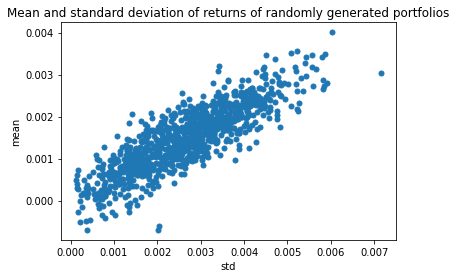

In [413]:
fig = plt.figure()
plt.plot(stds, means, 'o', markersize=5)
plt.xlabel('std')
plt.ylabel('mean')
plt.title('Mean and standard deviation of returns of randomly generated portfolios')
fig.show()

<ipython-input-492-fb6660234048>:6: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



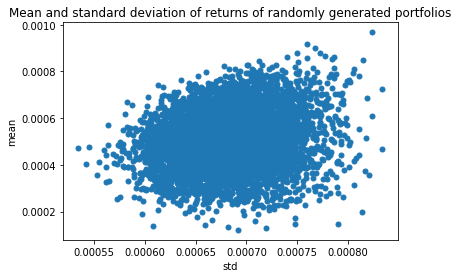

In [492]:
fig = plt.figure()
plt.plot(stds, means, 'o', markersize=5)
plt.xlabel('std')
plt.ylabel('mean')
plt.title('Mean and standard deviation of returns of randomly generated portfolios')
fig.show()

<ipython-input-486-fb6660234048>:6: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



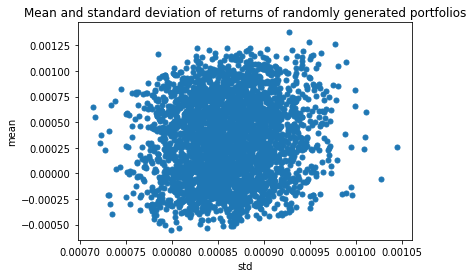

In [486]:
fig = plt.figure()
plt.plot(stds, means, 'o', markersize=5)
plt.xlabel('std')
plt.ylabel('mean')
plt.title('Mean and standard deviation of returns of randomly generated portfolios')
fig.show()

In [414]:
returns_short

Эмитент,Уркалий-ао,Ижсталь2ао,Сургнфгз
Дата,,,
2015-07-13,0.007854,0.000000,0.044959
2015-07-14,0.013178,0.000000,-0.031289
2015-07-15,0.021913,0.000000,0.020081
2015-07-16,-0.001314,0.013514,0.041097
2015-07-17,0.010142,0.000000,-0.018806
...,...,...,...
2016-10-14,0.001507,0.008850,-0.000691
2016-10-17,0.011976,0.038882,-0.024321
2016-10-18,0.026143,0.041500,-0.009789


In [367]:
returns[returns.columns.to_series().sample(np.random.randint(len(returns.columns)))].iloc[400:]

Эмитент,Лензол. ап,Электрцинк,ТЗА ао,Телеграф-п,РБК ао,НКНХ ао,АЛРОСА ао,Система ао,ЛУКОЙЛ,ГАЗПРОМ ао,...,ВыбСудЗ ап,ЧеркизГ-ао,Куйбазот-п,КМЗ,ГАЗ-Тек ао,ЭнергияРКК,ТКЗКК ап,МТС-ао,МагадЭн ап,МЕРИДИАН
Дата,,,,,,,,,,,,,,,,,,,,,
2015-07-13,0.004662,0.219136,0.000000,0.011935,0.001929,-0.006849,0.015781,0.009419,-0.011999,0.009475,...,0.000000,-0.010582,-0.048790,0.004695,0.0,0.000000,0.064539,0.008590,0.034191,0.000000
2015-07-14,0.047682,0.041304,0.000000,0.006757,0.000000,0.050262,-0.036887,-0.002608,-0.005641,0.008431,...,0.000000,0.003981,0.052446,0.000000,0.0,-0.003231,0.000000,-0.010862,0.041158,0.000000
2015-07-15,0.060233,0.097235,0.000000,0.016695,0.005764,-0.019803,-0.007800,-0.001568,0.015609,-0.026281,...,0.000000,0.013158,0.000000,-0.004695,0.0,0.000000,0.000000,-0.007078,-0.066691,0.000000
2015-07-16,-0.051403,-0.048353,0.000000,-0.006645,0.025533,0.013245,0.025581,0.031912,0.000650,0.010457,...,0.000000,0.014277,0.144195,0.020955,0.0,0.025560,0.000000,0.015913,0.000000,0.000000
2015-07-17,0.013101,0.009132,0.000000,0.001665,0.001866,-0.006601,-0.013412,0.001519,0.001543,-0.004170,...,-0.325108,0.000000,-0.050213,0.009174,0.0,0.009419,0.000000,-0.008152,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,0.002981,0.006309,0.005450,-0.005952,0.000000,-0.026889,0.022329,0.016484,0.019964,0.014208,...,-0.009756,-0.010818,0.004682,0.335768,0.0,-0.008467,-0.007151,-0.008859,0.010327,0.000000
2022-08-24,0.000000,0.336023,0.016173,0.005952,0.000000,0.013535,0.022122,-0.015031,0.004626,-0.008008,...,-0.014815,0.001928,-0.000935,-0.020454,0.0,0.145366,0.003582,-0.017741,0.000000,0.023811
2022-08-25,0.057820,-0.200920,-0.010753,0.000000,0.000000,0.024011,-0.011000,-0.007009,-0.015174,-0.005100,...,0.024571,-0.004387,0.019445,-0.086277,0.0,-0.073203,0.001191,0.019435,0.000000,-0.011834


In [323]:
returns.iloc[:, :np.random.randint(len(returns.columns))]

Эмитент,+МосЭнерго,Polymetal,iИСКЧ ао,iНПОНаука,iФармсинтз,АЛРОСА ао,АбрауДюрсо,Авангрд-ао,Акрон,Аптеки36и6,...,Башнефт ап,Белон ао,БурЗолото,ВТБ ао,ВХЗ-ао,Варьеган,Варьеган-п,ВолгЭнСб,ВолгЭнСб-п,ВыбСудЗ ао
Дата,,,,,,,,,,,,,,,,,,,,,
2013-11-28,-0.025666,0.037911,0.054126,0.000000,0.000000,-0.023819,0.015217,0.000000,0.010731,-0.082080,...,0.008956,-0.082144,0.000000,-0.001600,0.001887,0.000000,0.000000,-0.106515,-0.213629,0.000000
2013-11-29,-0.004840,-0.006231,0.001056,0.000000,0.064681,0.026668,-0.012837,0.000000,0.024061,0.023484,...,-0.005245,0.117561,0.025436,-0.004280,-0.001832,0.000000,0.000000,-0.088293,0.028874,0.000000
2013-12-02,0.015369,-0.030015,-0.022728,0.000000,-0.063969,0.000810,0.015385,0.000000,-0.024061,-0.021485,...,-0.028171,-0.001583,-0.025436,-0.011649,0.000000,0.000000,-0.181390,-0.150823,-0.073398,0.000000
2013-12-03,-0.018172,-0.046245,-0.184495,0.000000,-0.200176,0.004750,-0.011053,0.000000,-0.002698,-0.004002,...,-0.001983,0.009852,0.000000,-0.005112,0.000000,0.034552,0.000000,0.070780,0.047370,0.000000
2013-12-04,0.007209,-0.003490,0.307037,0.000000,0.190843,-0.009137,0.000309,0.000000,0.001972,-0.012611,...,0.000076,0.016529,0.000000,-0.000109,0.000000,0.000000,-0.019258,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,-0.001108,0.034159,-0.020759,-0.001055,-0.003384,0.022329,0.005540,0.000000,-0.013298,-0.000164,...,0.011503,0.037967,-0.001241,0.015948,0.032951,0.008306,-0.003552,-0.001496,-0.011628,-0.004831
2022-08-24,-0.004166,-0.009910,-0.035754,0.002110,-0.002262,0.022122,0.000000,0.000000,-0.009889,0.004253,...,0.020517,0.004890,0.026962,-0.003005,0.015058,-0.014161,0.001778,0.026589,0.062343,0.000000
2022-08-25,0.002224,0.006974,0.000253,-0.010593,-0.007959,-0.011000,0.008253,0.034486,-0.000231,0.000163,...,0.028307,-0.019705,0.065521,-0.007139,-0.017821,0.000000,-0.010714,-0.005848,0.008208,-0.026996


In [324]:
returns

Эмитент,+МосЭнерго,Polymetal,iИСКЧ ао,iНПОНаука,iФармсинтз,АЛРОСА ао,АбрауДюрсо,Авангрд-ао,Акрон,Аптеки36и6,...,ЧМК ао,ЧеркизГ-ао,Электрцинк,ЭнергияРКК,ЮТэйр ао,ЮУНК ао,ЮжКузб. ао,ЯТЭК ао,Якутскэн-п,Якутскэнрг
Дата,,,,,,,,,,,,,,,,,,,,,
2013-11-28,-0.025666,0.037911,0.054126,0.000000,0.000000,-0.023819,0.015217,0.000000,0.010731,-0.082080,...,-0.046382,0.012226,0.013423,-0.073781,0.004964,0.000000,0.000000,0.000000,-0.081782,-0.108358
2013-11-29,-0.004840,-0.006231,0.001056,0.000000,0.064681,0.026668,-0.012837,0.000000,0.024061,0.023484,...,-0.082065,0.001139,-0.006689,0.000000,0.000000,0.000000,-0.009209,0.000000,0.000000,0.067115
2013-12-02,0.015369,-0.030015,-0.022728,0.000000,-0.063969,0.000810,0.015385,0.000000,-0.024061,-0.021485,...,-0.058708,-0.031987,0.019934,0.037571,-0.164471,0.000000,-0.007683,-0.000010,0.093371,0.000000
2013-12-03,-0.018172,-0.046245,-0.184495,0.000000,-0.200176,0.004750,-0.011053,0.000000,-0.002698,-0.004002,...,-0.011696,0.017662,0.019545,-0.018344,0.178930,0.057103,0.000000,-0.104595,0.000000,-0.063370
2013-12-04,0.007209,-0.003490,0.307037,0.000000,0.190843,-0.009137,0.000309,0.000000,0.001972,-0.012611,...,0.043735,0.001538,0.015683,0.000000,0.004726,-0.115667,0.000000,0.021245,0.000000,-0.040043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,-0.001108,0.034159,-0.020759,-0.001055,-0.003384,0.022329,0.005540,0.000000,-0.013298,-0.000164,...,0.000000,-0.010818,0.006309,-0.008467,0.083382,-0.003534,0.230579,0.005469,-0.015297,-0.009461
2022-08-24,-0.004166,-0.009910,-0.035754,0.002110,-0.002262,0.022122,0.000000,0.000000,-0.009889,0.004253,...,0.046648,0.001928,0.336023,0.145366,-0.002225,0.245199,-0.061088,0.009500,0.000000,-0.017258
2022-08-25,0.002224,0.006974,0.000253,-0.010593,-0.007959,-0.011000,0.008253,0.034486,-0.000231,0.000163,...,0.002677,-0.004387,-0.200920,-0.073203,-0.023663,-0.083743,-0.028756,0.027533,-0.001929,0.000000


In [321]:
np.random.randint(len(returns.columns))

34

In [160]:
returns

Эмитент,+МосЭнерго,Polymetal,iИСКЧ ао,iНПОНаука,iФармсинтз,АЛРОСА ао,АбрауДюрсо,Авангрд-ао,Акрон,Аптеки36и6,...,ЧМК ао,ЧеркизГ-ао,Электрцинк,ЭнергияРКК,ЮТэйр ао,ЮУНК ао,ЮжКузб. ао,ЯТЭК ао,Якутскэн-п,Якутскэнрг
Дата,,,,,,,,,,,,,,,,,,,,,
2013-11-28,-0.025666,0.037911,0.054126,0.000000,0.000000,-0.023819,0.015217,0.000000,0.010731,-0.082080,...,-0.046382,0.012226,0.013423,-0.073781,0.004964,0.000000,0.000000,0.000000,-0.081782,-0.108358
2013-11-29,-0.004840,-0.006231,0.001056,0.000000,0.064681,0.026668,-0.012837,0.000000,0.024061,0.023484,...,-0.082065,0.001139,-0.006689,0.000000,0.000000,0.000000,-0.009209,0.000000,0.000000,0.067115
2013-12-02,0.015369,-0.030015,-0.022728,0.000000,-0.063969,0.000810,0.015385,0.000000,-0.024061,-0.021485,...,-0.058708,-0.031987,0.019934,0.037571,-0.164471,0.000000,-0.007683,-0.000010,0.093371,0.000000
2013-12-03,-0.018172,-0.046245,-0.184495,0.000000,-0.200176,0.004750,-0.011053,0.000000,-0.002698,-0.004002,...,-0.011696,0.017662,0.019545,-0.018344,0.178930,0.057103,0.000000,-0.104595,0.000000,-0.063370
2013-12-04,0.007209,-0.003490,0.307037,0.000000,0.190843,-0.009137,0.000309,0.000000,0.001972,-0.012611,...,0.043735,0.001538,0.015683,0.000000,0.004726,-0.115667,0.000000,0.021245,0.000000,-0.040043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,-0.001108,0.034159,-0.020759,-0.001055,-0.003384,0.022329,0.005540,0.000000,-0.013298,-0.000164,...,0.000000,-0.010818,0.006309,-0.008467,0.083382,-0.003534,0.230579,0.005469,-0.015297,-0.009461
2022-08-24,-0.004166,-0.009910,-0.035754,0.002110,-0.002262,0.022122,0.000000,0.000000,-0.009889,0.004253,...,0.046648,0.001928,0.336023,0.145366,-0.002225,0.245199,-0.061088,0.009500,0.000000,-0.017258
2022-08-25,0.002224,0.006974,0.000253,-0.010593,-0.007959,-0.011000,0.008253,0.034486,-0.000231,0.000163,...,0.002677,-0.004387,-0.200920,-0.073203,-0.023663,-0.083743,-0.028756,0.027533,-0.001929,0.000000


In [105]:
selected_clear_pivot

Эмитент,+МосЭнерго,Polymetal,Yandex clA,iАвиастКао,iИСКЧ ао,iНПОНаука,iФармсинтз,АЛРОСА ао,АбрауДюрсо,Авангрд-ао,...,Электрцинк,ЭнелРос ао,ЭнергияРКК,ЮТэйр ао,ЮУНК ао,Югра-кред,ЮжКузб. ао,ЯТЭК ао,Якутскэн-п,Якутскэнрг
Дата,,,,,,,,,,,,,,,,,,,,,
2015-03-20,0.71450,484.0,866.0,0.17650,10.05,134.0,12.4500,78.00,106.00,295.0,...,362.00,0.7780,4000.0,11.300,1580.0,1215.0,660.0,20.000,0.16150,0.17000
2015-03-23,0.69550,483.5,874.0,0.17250,9.60,134.0,12.2000,74.90,106.50,295.0,...,371.00,0.7730,4000.0,10.950,1460.0,1215.0,646.0,14.000,0.16150,0.17400
2015-03-24,0.69600,476.0,866.0,0.17250,9.75,134.0,12.5000,75.50,94.00,295.0,...,390.00,0.7740,4000.0,11.000,1515.0,1215.0,630.0,14.000,0.16000,0.16000
2015-03-25,0.69950,492.5,885.0,0.17000,9.95,134.0,12.3000,73.60,96.50,295.0,...,404.00,0.7650,3960.0,11.000,1515.0,1215.0,675.0,12.200,0.16000,0.16000
2015-03-26,0.70000,488.5,880.0,0.16150,9.85,134.0,12.4500,70.20,94.00,295.0,...,391.00,0.7920,3960.0,10.450,1410.0,1215.0,621.0,15.150,0.16350,0.16800
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,0.90200,375.2,2082.2,0.27000,41.00,94.7,2.2125,34.87,90.50,427.5,...,79.50,0.2307,2940.0,4.500,2825.0,607.5,675.0,55.000,0.12975,0.13150
2022-08-24,0.89825,371.5,2085.2,0.26925,39.56,94.9,2.2075,35.65,90.50,427.5,...,111.25,0.2470,3400.0,4.490,3610.0,607.5,635.0,55.525,0.12975,0.12925
2022-08-25,0.90025,374.1,2118.8,0.27100,39.57,93.9,2.1900,35.26,91.25,442.5,...,91.00,0.2441,3160.0,4.385,3320.0,607.5,617.0,57.075,0.12950,0.12925


In [125]:
selected_clear_pivot

Эмитент,+МосЭнерго,Polymetal,iИСКЧ ао,iНПОНаука,iФармсинтз,АЛРОСА ао,АбрауДюрсо,Авангрд-ао,Акрон,Аптеки36и6,...,ЧМК ао,ЧеркизГ-ао,Электрцинк,ЭнергияРКК,ЮТэйр ао,ЮУНК ао,ЮжКузб. ао,ЯТЭК ао,Якутскэн-п,Якутскэнрг
Дата,,,,,,,,,,,,,,,,,,,,,
2013-11-27,0.82875,282.10,17.4765,109.67,14.0380,35.0500,96.52,300.0,954.7,21.700,...,1037.0,520.30,296.00,3993.0,20.497,1700.0,1200.0,10.0000,0.16300,0.17820
2013-11-28,0.80775,293.00,18.4485,109.67,14.0380,34.2250,98.00,300.0,965.0,19.990,...,990.0,526.70,300.00,3709.0,20.599,1700.0,1200.0,10.0000,0.15020,0.15990
2013-11-29,0.80385,291.18,18.4680,109.67,14.9760,35.1500,96.75,300.0,988.5,20.465,...,912.0,527.30,298.00,3709.0,20.599,1700.0,1189.0,10.0000,0.15020,0.17100
2013-12-02,0.81630,282.57,18.0530,109.67,14.0480,35.1785,98.25,300.0,965.0,20.030,...,860.0,510.70,304.00,3851.0,17.475,1700.0,1179.9,9.9999,0.16490,0.17100
2013-12-03,0.80160,269.80,15.0115,109.67,11.4995,35.3460,97.17,300.0,962.4,19.950,...,850.0,519.80,310.00,3781.0,20.899,1799.9,1179.9,9.0068,0.16490,0.16050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-23,0.90200,375.20,41.0000,94.70,2.2125,34.8700,90.50,427.5,8740.0,6.100,...,1780.0,1425.00,79.50,2940.0,4.500,2825.0,675.0,55.0000,0.12975,0.13150
2022-08-24,0.89825,371.50,39.5600,94.90,2.2075,35.6500,90.50,427.5,8654.0,6.126,...,1865.0,1427.75,111.25,3400.0,4.490,3610.0,635.0,55.5250,0.12975,0.12925
2022-08-25,0.90025,374.10,39.5700,93.90,2.1900,35.2600,91.25,442.5,8652.0,6.127,...,1870.0,1421.50,91.00,3160.0,4.385,3320.0,617.0,57.0750,0.12950,0.12925
